<a href="https://colab.research.google.com/github/WyvernCore/ARI1101---Data-Science-individual/blob/master/Hyperparam_tuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Hyperparameter tuning with Optuna

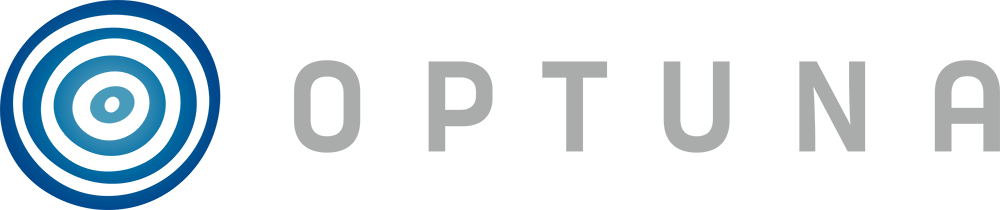

In [ ]:
!apt-get install -y xvfb

!pip install \
    gym==0.21 \
    gym[box2d] \
    pytorch-lightning==1.6.0 \
    optuna \
    pyvirtualdisplay

#### Setup virtual display

In [2]:
from pyvirtualdisplay import Display
Display(visible=False, size=(1400,900)).start() #create the display

#### Import the necessary code libraries

In [18]:
import copy
import gym 
import torch
import random
import statistics
import optuna

import numpy as np
import torch.nn.functional as F

from collections import deque, namedtuple
from IPython.display import HTML
from base64 import b64encode

from torch import Tensor, nn #create the Neural network
from torch.utils.data import DataLoader #load training data
from torch.utils.data.dataset import IterableDataset #Define where we get our data
from torch.optim import AdamW #optimizer

from pytorch_lightning import LightningModule, Trainer 
from pytorch_lightning.callbacks import EarlyStopping

from gym.wrappers import RecordVideo, RecordEpisodeStatistics, TimeLimit

from optuna.integration import PyTorchLightningPruningCallback

In [4]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu' #run code on gpu if avialable 
num_gpus = torch.cuda.device_count()

In [5]:
def display_video(episode = 0): #convert video to html to render enviroment here
  video_file = open(f'/content/videos/rl-video-episode-{episode}.mp4',"r+b").read()
  video_url = f'data:video/mp4;base64, {b64encode(video_file).decode()}'
  return HTML(f"<video width=600 controls><source src='{video_url}'></video>")

#### Create the Deep Q-Network

In [14]:
class DQN(nn.Module):

  def __init__(self, hidden_size,  obs_size, n_actions): #pass the amount of hidden layers, the observation size (vector of features) [x, y, z], number of actions [q1, q2, q3]
    super().__init__()
    self.net = nn.Sequential(
                             nn.Linear(obs_size, hidden_size),
                             nn.ReLU(), 
                             nn.Linear(hidden_size, hidden_size), 
                             nn.ReLU(), 
                             nn.Linear(hidden_size, n_actions)
                            )
  
  def forward(self, x): #What happens when an observation is passed
    return self.net(x.float()) #tensor foating point values

#### Create the policy

In [7]:
#fn: state -> action || [p1, p2, p3]

def e_greedy(state, env, net, epsilon=0.0): #The E-Greedy Policy 
  if np.random.random() < epsilon:
    action = env.action_space.sample() #take a random action
  else: # 1 - e
    state = torch.tensor([state]).to(device) #Pass a batch of observations | device -> CPU or GPU
    q_values = net(state) #Produce q_values from NN
    _, action = torch.max(q_values, dim=1) #Take the max q_value action | torch.max passes two values, the actual value and the index (we only care about the index)
    action = int(action.item()) #make sure its a integer
  return action

#### Create the replay buffer

In [8]:
class ReplayBuffer: #Store enviroment observations (kinda like a database) | Stored as [State, Action, Reward, Next State] 
  def __init__(self, capacity): #defining the capacity of the replay buffer
    self.buffer = deque(maxlen=capacity) #Using a queue data structure

  def __len__(self):  #return the length of the buffer
    return len(self.buffer)
  
  def append(self, experience): #save experience in the database
    self.buffer.append(experience)
  
  def sample(self, batch_size):
    return random.sample(self.buffer, batch_size) #get a sample of explisit buffer size

In [9]:
class RLDataset(IterableDataset): #class to allow pytorch to select a sample from buffer one at a time (the batch)
  def __init__(self, buffer, sample_size=200): #go through each element one at a time
    self.buffer = buffer
    self.sample_size = sample_size
  
  def __iter__(self): #take a sample from buffer and return elements one at a time
    for exp in self.buffer.sample(self.sample_size):
      yield exp

#### Create the environment

In [10]:
def create_environment(name): #Using gym to easily create an enviroment and pass the name of it
  env = gym.make(name)
  env = TimeLimit(env, max_episode_steps=400)
  env = RecordVideo(env, video_folder='./videos', episode_trigger=lambda x: x%50 == 0) #record every fifty episodes
  env = RecordEpisodeStatistics(env) #Keep history of rewards from the env
  return env

#### Create the test/sampling function

#### Create the Deep Q-Learning algorithm

In [13]:
class DeepQLearning(LightningModule): #Implementing the Algorithm

  # Initialize
  def __init__(self, env_name, policy=e_greedy, capacity=100_000, 
               batch_size=256, lr=0.1, hidden_size=128, gamma=0.99, loss_fn=F.smooth_l1_loss,
               optim=AdamW, eps_start=1.0, eps_end=0.15, eps_last_episode=100, samples_per_epoch=10_000
               , sync_rate=10):
    
    super().__init__()
    self.env = create_environment(env_name) #pass the enviroment name to create the environment

    obs_size = self.env.observation_space.shape[0] #get observation size
    n_actions  = self.env.action_space.n #get action size

    self.q_net = DQN(hidden_size, obs_size, n_actions) #Instansiate the Deep Q-Network

    self.target_q_net = copy.deepcopy(self.q_net) #Create a copy for target policy

    self.policy = policy #Get the policy
    self.buffer = ReplayBuffer(capacity=capacity) #create the reply buffer

    self.save_hyperparameters() #keep passed hyperparameters saved

    while len(self.buffer) < self.hparams.samples_per_epoch: #keep filling buffer
        print(f"{len(self.buffer)} samples in expience buffer. Filling....")
        self.play_episode(epsilon=self.hparams.eps_start)

  @torch.no_grad() #treat actions as constants 
  def play_episode(self, policy=None, epsilon=0.):
    state = self.env.reset()
    done = False

    while not done:
      if policy: #if a policy is present get action selected by the policy
        action = policy(state, self.env, self.q_net, epsilon=epsilon)
      else: #if not pick a random action
        action = self.env.action_space.sample()
      next_state, reward, done, info = self.env.step(action) #take an action in the enviroment
      exp = (state, action, reward, done, next_state) #store the exp to be stored in the exp replay buffer
      self.buffer.append(exp) #save in the buffer 
      state = next_state #set next to curr
    
  # Foward Pass
  
  def forward(self, x): #take a state input -> produce q value
    return self.q_net(x)

  # Configure Optimizers

  def configure_optimizers(self): 
    q_net_optimizer = self.hparams.optim(self.q_net.parameters(), lr=self.hparams.lr)
    return [q_net_optimizer] #might be more than one NN thus rap in list

  # Create dataloader

  def train_dataloader(self):
    dataset = RLDataset(self.buffer, self.hparams.samples_per_epoch)
    dataloader = DataLoader(
        dataset = dataset,
        batch_size=self.hparams.batch_size
    )
    return dataloader

  # Training step

  def training_step(self, batch, batch_idx):
    states, actions, rewards, dones, next_states = batch #retrieve data from batch
    actions = actions.unsqueeze(1) #create an extra dim to solve size diff
    rewards = rewards.unsqueeze(1)
    dones = dones.unsqueeze(1)

    state_action_values = self.q_net(states).gather(1, actions) #get Q(s,a) value from neural network

    next_action_values, _ = self.target_q_net(next_states).max(dim=1, keepdim=True) #keepdim keeps orginal dim, get target q(s', a') values
    next_action_values[dones] = 0.0 #set done values to zero
      
    expected_state_action_values = rewards + self.hparams.gamma * next_action_values # gamma is the discount factor

    loss = self.hparams.loss_fn(state_action_values, expected_state_action_values) #compute loss values with the mean sq diff (varient)
    self.log('episode/Q-Error', loss)

    return loss

  # Training epoch end

  def training_epoch_end(self, training_step_outputs):
    epsilon = max(
        self.hparams.eps_end,
        self.hparams.eps_start - self.current_epoch /  self.hparams.eps_last_episode
    )

    self.play_episode(policy=self.policy, epsilon=epsilon)
    self.log('episode/Return', self.env.return_queue[-1])
    returns = list(self.env.return_queue)[-100:] #get a list of results from the previous 100 episodes
    self.log('hp_metric', statistics.mean(returns)) #keep track of the mean returns of the last 100 episodes

    if self.current_epoch % self.hparams.sync_rate == 0:
      self.target_q_net.load_state_dict(self.q_net.state_dict())

#### Create the objective function

In [22]:
def objective(trial):
  lr = trial.suggest_float("lr", 1e-5, 1e-1, log=True) #Suggest between 1e-5 and 1e-1 (scale log)
  gamma = trial.suggest_float("gamma", 0.0, 1.0)

  algorithm = DeepQLearning('LunarLander-v2', lr=lr, gamma=gamma)

  callback = PyTorchLightningPruningCallback(trial, monitor='hp_metric')
  trainer = Trainer(
      gpus=num_gpus,
      max_epochs=1_000,
      callbacks=[callback] #improved early stopping method
  )

  hyperparameters = dict(lr=lr, gamma=gamma)
  trainer.logger.log_hyperparams(hyperparameters)
  trainer.fit(algorithm)

  return trainer.callback_metrics['hp_metric'].item() #make sure its an integer, report back the results achieved 

#### Create the optimization study

In [19]:
pruner = optuna.pruners.SuccessiveHalvingPruner()
study = optuna.create_study(direction="maximize", pruner=pruner)

[I 2022-07-25 15:32:08,233] A new study created in memory with name: no-name-5e56a8a7-7f6a-41a6-bc41-3d548fa92c07


#### Purge logs and run the visualization tool (Tensorboard)

In [20]:
!rm -r /content/lightning_logs/
!rm -r /content/videos/
%load_ext tensorboard
%tensorboard --logdir /content/lightning_logs/

rm: cannot remove '/content/lightning_logs/': No such file or directory
rm: cannot remove '/content/videos/': No such file or directory


<IPython.core.display.Javascript object>

#### Run the hyperparameter search

In [ ]:
study.optimize(objective, n_trials=20) #pass objective function

#### Select and use the best hyperparameters

In [24]:
study.best_params

{'gamma': 0.9927989694107725, 'lr': 0.0001766892952568603}

In [25]:
!rm -r /content/lightning_logs/
!rm -r /content/videos/
%load_ext tensorboard
%tensorboard --logdir /content/lightning_logs/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 900), started 4:11:09 ago. (Use '!kill 900' to kill it.)

<IPython.core.display.Javascript object>

In [26]:
algorithm = DeepQLearning('LunarLander-v2', **study.best_params) # {'gamma': 0.9927989694107725, 'lr': 0.0001766892952568603}

trainer = Trainer(
    gpus=num_gpus,
    max_epochs=10_000,  
)

trainer.fit(algorithm)

0 samples in expience buffer. Filling....
124 samples in expience buffer. Filling....
239 samples in expience buffer. Filling....
355 samples in expience buffer. Filling....
470 samples in expience buffer. Filling....
568 samples in expience buffer. Filling....
640 samples in expience buffer. Filling....
769 samples in expience buffer. Filling....
834 samples in expience buffer. Filling....
936 samples in expience buffer. Filling....
1052 samples in expience buffer. Filling....
1132 samples in expience buffer. Filling....
1237 samples in expience buffer. Filling....
1321 samples in expience buffer. Filling....
1426 samples in expience buffer. Filling....
1506 samples in expience buffer. Filling....
1604 samples in expience buffer. Filling....
1675 samples in expience buffer. Filling....
1765 samples in expience buffer. Filling....
1850 samples in expience buffer. Filling....
1958 samples in expience buffer. Filling....
2050 samples in expience buffer. Filling....
2200 samples in expien

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
Missing logger folder: /content/lightning_logs

  | Name         | Type | Params
--------------------------------------
0 | q_net        | DQN  | 18.2 K
1 | target_q_net | DQN  | 18.2 K
--------------------------------------
36.4 K    Trainable params
0         Non-trainable params
36.4 K    Total params
0.145     Total estimated model params size (MB)


9475 samples in expience buffer. Filling....
9541 samples in expience buffer. Filling....
9660 samples in expience buffer. Filling....
9782 samples in expience buffer. Filling....
9901 samples in expience buffer. Filling....


Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:727: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


#### Check the resulting policy

In [ ]:
display_video()